# Recommending Proximity Graphs According the Similarity Among Problems

-------------------------------------------------------------------------
### Summary:
- Data augmentation
- Similarity
    - Feature analysis and selection
    - Clustering
- A model composed of several models?

-------------------------------------------------------------------------

### Variables overview and terminologies:
- *NN*: number of nearest neighbors for indexing algorithms
- *R*: number of restarts for searching algorithms
- *k*: number of elements retrieved from queries
- Graph types (*G*): BF-kNN, NNDescent, and NSW
- Graph configuration (*&theta;*): a tuple defined as (*G, NN, R, k*)
- Dataset (*d*): real (images) and synthetic data
- Meta-features (*mf*): measures that describe *d*
- Meta-target (*mt*): the performance achieved by a given graph configuration
- Meta-instance (*mi*): a tuple difined as (*mf, &theta;, mt*)
- Meta-base or meta-dataset (*mb*): a set composed by meta-instances

In [3]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

plt.style.use('bmh')
os.chdir('/home/seidi/Repositories/mestrado_final/')

import utils
# Reading data
mb = utils.read_mb()
mb_int = utils.read_int_mb()
mf = utils.read_mf()

# Reading results
path = 'src/notebooks/2020.11.30/results/scores'
score_files = [os.path.join(path, f) for f in os.listdir(path) if os.path.isfile(os.path.join(path,f))]
scores = pd.DataFrame()
for sf in score_files:
    df = pd.read_csv(sf)
    file_name = sf.split('/')[-1].split('.')[0]
    if 'target' in df.columns:
        df = df[df.target == 'Recall']
    if 'mse' in df.columns:
        df.mse = df.mse ** (1/2)
        df = df.rename(columns={'mse': 'rmse'})
    
    df = df.rename(columns={'approach': 'method'})

    if file_name.startswith('clus'):
        df['details'] = 'eps=' + df.eps.astype(float).round(2).astype(str)
    else:
        df['details'] = np.nan
    df['method'] = file_name
    
    df['base'] = df['base'].apply(lambda x: x.split('_')[0])

    df = df[['base', 'method', 'r2', 'rmse', 'details']]
    scores = pd.concat([scores, df])

scores

,base,method,r2,rmse,details
0,texture,clustering_inter,0.985075,0.021596,eps=4.0
1,texture,clustering_inter,0.985075,0.021596,eps=4.25
2,texture,clustering_inter,0.985075,0.021596,eps=4.5
3,texture,clustering_inter,0.985075,0.021596,eps=4.75
4,texture,clustering_inter,0.984457,0.022039,eps=5.0
...,...,...,...,...,...
2,moments,similarity_mb=int_k=5,0.975035,0.027382,NaN
3,mnist121d,similarity_mb=int_k=5,0.990468,0.022883,NaN
4,fashion,similarity_mb=int_k=5,0.846797,0.097394,NaN
5,colorHisto,similarity_mb=int_k=5,0.990686,0.017495,NaN


# Data augmentation (interpolation)
### Recall values were interpoalted for unseen NN and R parameters for each k and graph type

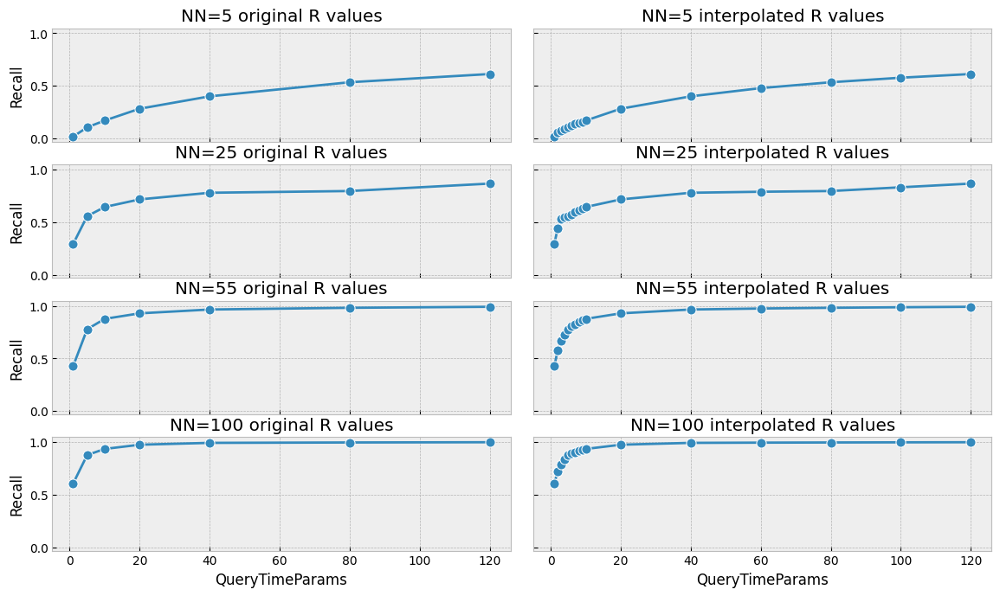

In [4]:
base = 'sift_999900'
graph_type = 0
k = 30

rr_original = [1, 5, 10, 20, 40, 80, 120, 240]
nn_original = [5, 25, 55, 100]

plt_cfg = {
    'x': 'QueryTimeParams',
    'y': 'Recall',
    'marker': 'o',
    'markersize': 8
}

fig, axes = plt.subplots(4, 2, figsize=(14,8), sharey=True, sharex=True, dpi=100)
axes = iter(axes.reshape(-1))
plt.subplots_adjust(wspace=0.05)

for NN in nn_original:
    tmp = mb_int[
        (mb_int.IndexParams == NN) &
        (mb_int.graph_type == 0) &
        (mb_int.index == base)
    ]
    ax = next(axes)
    ax.set_title(f'NN={NN} original R values')
    sns.lineplot(data=tmp[tmp.QueryTimeParams.isin(rr_original)], ax=ax, **plt_cfg)

    tmp = mb_int[
        (mb_int.IndexParams == NN) &
        (mb_int.graph_type == 0) &
        (mb_int.index == base)
    ]
    ax = next(axes)
    ax.set_title(f'NN={NN} interpolated R values')
    sns.lineplot(data=tmp, ax=ax, **plt_cfg)

    NN += 10


## The difference among performances achieved by each meta-base (original and interpoalted) is not significant
- Scores obtained from the GMM approach (paper ADBIS), i.e. using all datasets execept the target (testing) one for training

method
gmm_int     0.865721
gmm_orig    0.880243
Name: r2, dtype: float64

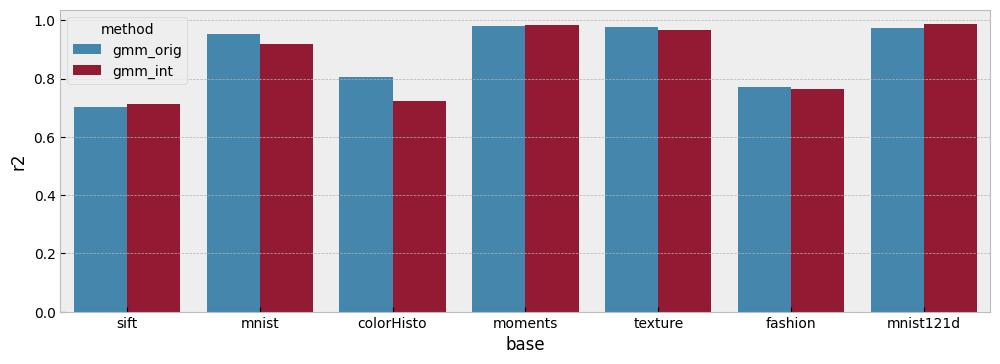

In [5]:
gmms = scores[scores.method.str.startswith('gmm')].copy()
gmms.method = gmms.method.apply(lambda x: 'gmm_orig' if x.endswith('original') else 'gmm_int')
plt.figure(figsize=(12,4), dpi=100)

sns.barplot(x='base', y='r2', hue='method', data=gmms)
gmms.groupby('method').r2.mean()

# Defining a good similarity space by evaluating feature relevances
Here we expect to define a suitable similarity space for datasets according the most relevant meta-features (regarding recall only). Thus, we perform a feature selection process, considering the following techniques: pca, linear correlation (pearson), and feature importances from random forests.

In [6]:
not_metafeatures = ['Recall', 'IndexParams', 'QueryTimeParams', 'graph_type', 'k_searching', 'QueryTime', 'DistComp', 'IndexTime']

# Pearson correlation, where features lie in quantile >= 0.9
pearson_corr = mb.corr().Recall.abs().sort_values(ascending=False)
pearson_corr.drop(not_metafeatures, inplace=True)
PEARSON_FEATURES = pearson_corr[pearson_corr > pearson_corr.quantile(.9)].index.values
PEARSON_FEATURES

importances = pd.read_csv('data/feature_importances.csv')
importances.target.value_counts()
values = importances[importances.target == 'Recall']
values.importance = values.importance/values.importance.sum()
RF_FEATURES= values[values.importance >= values.importance.quantile(.9)].feature.values
RF_FEATURES

print(PEARSON_FEATURES, RF_FEATURES, sep='\n')

['lid_mean' 'rv' 'attr_ent.mean' 'nr_inst' 'min.mean']
['lid_entropy' 'rv' 'nr_inst' 'lid_mean' 'attr_ent.mean']


In [7]:
mb.reset_index(inplace=True)
#mb.set_index('base', inplace=True)

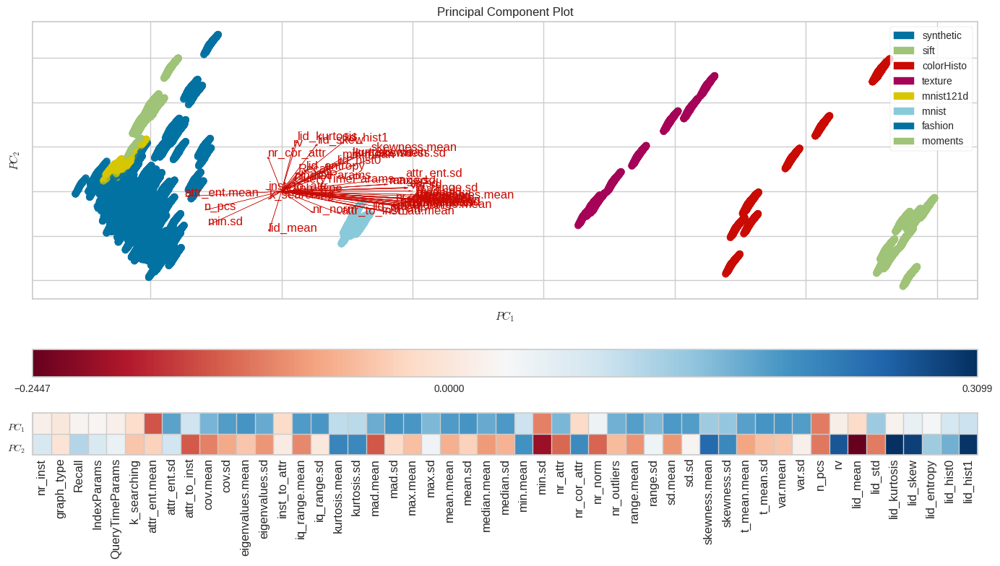

<AxesSubplot:title={'center':'Principal Component Plot'}, xlabel='$PC_1$', ylabel='$PC_2$'>

In [8]:
from yellowbrick.features import PCA as YBPCA

features = mb.drop(['base', 'QueryTime', 'IndexTime', 'DistComp'], axis=1).columns
labels = mb.base.values #.apply(lambda x: 'synthetic' if x.startswith('base') else x.split('_')[0]).to_frame()
labels = pd.Series(['synthetic' if x.startswith('base') else x.split('_')[0] for x in labels])

plt.figure(figsize=(14,8), dpi=100)
pca = YBPCA(scale=True, proj_features=True,heatmap=True, classes=pd.unique(labels))
pca.features = features
pca.fit_transform(mb[features], labels.astype('category').cat.codes)
pca.show()

# print(labels)
# print(labels.astype('category').cat.codes)

# Clustering approach
### From these selected features, we employed the DBSCAN algorithm to cluster datasets. The overall idea is to define good features that better represent a similarity space according a specific meta-target. However, employing the DBSCAN brings us the issue of choosing a good eps value. To overcome this issue we did the following analysis. First, for each feature selection method we performed a grid search (GS) over different eps values. Second, we choose the feature selection method that presented a better average performance in the GS process. Third, considering this feature selection method we did some evaluations to understand how the similarity space behaves.

### GS for eps values according each feature selection method
- Different ranges of eps values were choosen for each feature selection method because different similarity spaces are built from different features.
- We set min_pts=2 to force that each cluster has at least two datasets; this way we intend to build more generic models
- Filtering FS methods and eps that reached at least an r2 average of 0.9
- PCA did not reached for any eps value
- The RF overcame all the other methods

In [9]:
scores = pd.read_csv('data/results/clustering_scores.csv')
scores.method = scores.method.apply(lambda x: f"eps={float(x.split('=')[-1]):.2f}")
group = scores.groupby(['feature_selection_method', 'method']).r2.describe()[['mean', 'std', 'min', 'max']]
group[group['mean'] > 0.9]

FileNotFoundError: [Errno 2] No such file or directory: 'data/results/clustering_scores.csv'

### 3) Evaluating the similarity space of datasets provided by the features selected from RF importances
- According the grid search process, the best eps value was 0.3
- The objective of this analysis is to find a good argument for choosing the eps value, instead of performing a grid search process.

### Distances from a complete graph (k-NN with k=number of instances)

Distances from a complete graph (k-NN with k=number of instances)


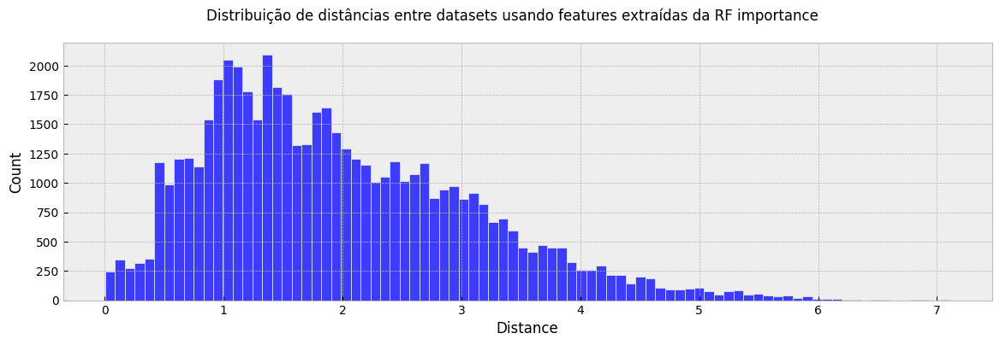

In [26]:
from sklearn.neighbors import NearestNeighbors
import seaborn as sns
import matplotlib.pyplot as plt
mf_new = mf[RF_FEATURES].copy()
sc = StandardScaler()
sc.fit(mf_new)
mf_new.loc[:, :] = sc.transform(mf_new)

knng = NearestNeighbors(n_neighbors=mf_new.shape[0])
knng.fit(mf_new)
dist, ix = knng.kneighbors(mf_new)
dist = dist[:, 1:]
lt_dist = dist[np.tril_indices(dist.shape[0], -1)]
plt.figure(figsize=(14,4), dpi=100)
plt.suptitle('Distribuição de distâncias entre datasets usando features extraídas da RF importance')
plt.xlabel('Distance')
sns.histplot(lt_dist)
print('Distances from a complete graph (k-NN with k=number of instances)')

In [27]:
import scipy.stats as sp

print("Medidas estatísticas extraídas do vetor de distâncias")
print(f'Mean={np.mean(lt_dist):.2f}')
print(f'Median={np.median(lt_dist):.2f}')
print(f'Std={np.std(lt_dist):.2f}')
print(f'Min={np.min(lt_dist):.2f}')
print(f'Max={np.max(lt_dist):.2f}')
print(f'Entropy={sp.entropy(lt_dist):.2f}')
print(f'Skew={sp.skew(lt_dist):.2f}')
print(f'Kurtosis={sp.kurtosis(lt_dist):.2f}')
print(f'Q1={np.quantile(lt_dist, 0.25):.2f}')
print(f'Q2={np.quantile(lt_dist, 0.5):.2f}')
print(f'Q3={np.quantile(lt_dist, 0.75):.2f}')

Medidas estatísticas extraídas do vetor de distâncias
Mean=1.96
Median=1.77
Std=1.10
Min=0.00
Max=7.11
Entropy=10.74
Skew=0.77
Kurtosis=0.30
Q1=1.11
Q2=1.77
Q3=2.68


### All distances from the k-NN with k=1
- Observing the lineplot we can notice that there are regions where the curve "stratches", i.e. there is a significant change; 
- Notice between 0.2 and 0.3 in y-axis; and above 0.43; these values may contain good eps values because we can consider it as outliers;
- Also, considering distance values above the 90th percentile as outilers, we can find a good eps value (0.3). Defining this percentile we intend to ensure that 90% of instances belong to a cluster. 

0.3770623950296368


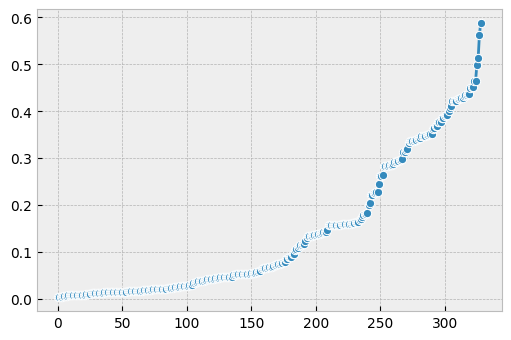

In [28]:
knng = NearestNeighbors(n_neighbors=2)
knng.fit(mf_new)
dist, ix = knng.kneighbors(mf_new)
dist = dist[:, 1:].reshape(-1)
dist = np.sort(dist)
plt.figure(figsize=(6,4), dpi=100)
sns.lineplot(np.arange(len(dist)), dist, marker='o')
print(np.quantile(dist, 0.9))

<AxesSubplot:xlabel='base', ylabel='r2'>

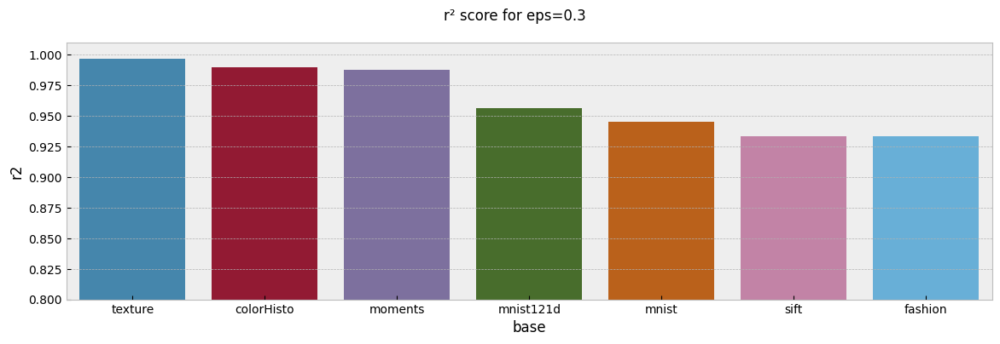

In [34]:
final_scores = scores[(scores.feature_selection_method == 'rf') & (scores.method.str.endswith('29'))].copy()
final_scores.base = final_scores.base.apply(lambda x: x.split('_')[0])
final_scores.sort_values(by='r2', ascending=False, inplace=True)
final_scores.reset_index(inplace=True, drop=True)

plt.figure(figsize=(14,4), dpi=100)
plt.ylim(0.8, 1.01)
plt.suptitle('r² score for eps=0.3')
sns.barplot(x='base', y='r2', data=final_scores)

# ToDo: number of clusters 

## -----------------------------------------------------------------------------------------------

# Evaluating the impact of adding new meta-features and meta-instances
- Grouping by the r² score
- Plotting

In [11]:
all_scores = pd.read_csv('src/notebooks/overview/results/old_new_evaluation.csv')
print('Grouping by the r² score')
all_scores.groupby('method').r2.describe()[['mean', 'std', 'min', 'max']].sort_values(by='mean')

Grouping by the r² score


,mean,std,min,max
method,,,,
old_mfs+old_bases,0.491598,0.476379,-0.047991,0.993572
new_mfs+old_bases,0.767364,0.159346,0.583505,0.964180
old_mfs+new_bases,0.783021,0.361105,-0.029943,0.992735
new_mfs+new_bases,0.817964,0.153197,0.579655,0.976023


In [14]:
scores_path = 'data/results/clustering/clustering_scores.csv'
scores = pd.read_csv(scores_path)

adbis = all_scores[all_scores.method == 'old_mfs+old_bases'].copy()
adbis.method = 'GMM'
scores = scores[(scores.feature_selection_method == 'rf') & (scores.target.isin(['Recall', 'QueryTime']))]
scores.method = 'Clustering'
scores = scores[['base', 'r2', 'method', 'target']]


# plt.figure(figsize=(14,4), dpi=100)
# plt.ylim(0, 1)
# sns.barplot(x='method', y='r2', data=all_scores)


<AxesSubplot:xlabel='method', ylabel='r2'>

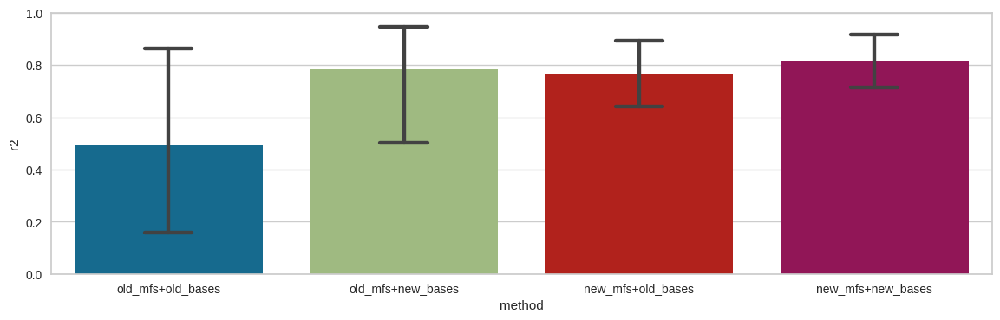

In [32]:
plt.figure(figsize=(14,4), dpi=100)
plt.ylim(0, 1)
sns.barplot(x='method', y='r2', data=all_scores, capsize=.2)

# Recommendations (update)
- All meta-targets

In [7]:
scores_path = 'data/results/clustering_scores.csv'
preds_path = 'data/results/clustering_predictions.csv'
# scores_path = 'data/results/clustering_scores_clf.csv'
# preds_path = 'data/results/clustering_predictions_clf.csv'
scores = pd.read_csv(scores_path)
scores = scores[scores.feature_selection_method == 'rf']
x = scores.groupby(['target', 'base'])[['r2', 'rmse']].mean().copy()
x.r2 = x.r2.round(4) * 100
x.r2 = x.r2.round(2).astype(str) + '%'
x.rmse = x.rmse.round(2)
x
# scores.method = scores.method.apply(lambda x: f"eps={float(x.split('=')[-1]):.2f}")
# recall_scores = scores[(scores.target == 'Recall') & (scores.method.str.endswith('38'))]
# ix = np.concatenate([recall_scores.index.values, scores[(scores.target != 'Recall')].index.values])
# scores = scores[scores.index.isin(ix)].reset_index(drop=True)
# group = scores.groupby(['target']).r2.describe()[['mean', 'std', 'min', 'max']]
# group.round(3)

r2  rmse
target    base                            
DistComp  colorHisto_67940    97.63%  0.29
          fashion_69900       97.84%  0.30
          mnist121d_69900     99.33%  0.16
          mnist_69900         99.92%  0.06
          moments_67940       99.86%  0.07
          sift_999900         97.74%  0.27
          texture_67940       94.28%  0.45
IndexTime colorHisto_67940    79.29%  0.56
          fashion_69900       -93.5%  2.69
          mnist121d_69900     74.52%  0.77
          mnist_69900        -23.09%  2.07
          moments_67940       98.51%  0.14
          sift_999900       -134.32%  3.25
          texture_67940       98.87%  0.12
QueryTime colorHisto_67940    85.56%  0.54
          fashion_69900       82.44%  0.76
          mnist121d_69900     94.13%  0.38
          mnist_69900          95.6%  0.37
          moments_67940       99.29%  0.12
          sift_999900         88.19%  0.53
          texture_67940       75.29%  0.67
Recall    colorHisto_67940    98.98%  0.02
          fashion_69900        93.3%  0.06
          mnist121d_69900     95.62%  0.05
          mnist_69900         94.51%  0.06
          moments_67940       98.73%  0.02
          sift_999900         93.34%  0.07
          texture_67940       99.62%  0.01

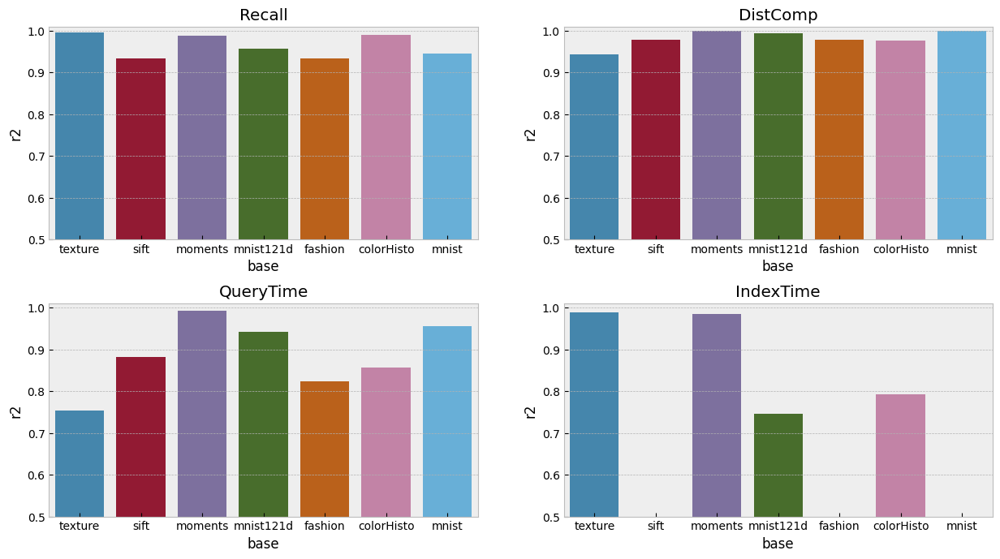

In [32]:
fig, axes = plt.subplots(2,2,dpi=100, figsize=(15,8))
axes = axes.reshape(-1)
scores.base = scores.base.apply(lambda x: x.split('_')[0])
for ax, target in zip(axes, scores.target.unique()):
    ax.set_ylim(0.5, 1.01)
    sns.barplot(x='base', y='r2', data=scores[scores.target == target], ax=ax)
    ax.set_title(target)
    plt.subplots_adjust(hspace=0.3)

In [26]:
preds = pd.read_csv(preds_path)
preds = preds[preds.feature_selection_method == 'rf']
# preds.method = preds.method.apply(lambda x: f"eps={float(x.split('=')[-1]):.2f}")
preds

,y_true,y_pred,IndexParams,QueryTimeParams,k_searching,base,graph_type,target,feature_selection_method
35520,0.998013,0.998743,55.0,220.0,30,texture_67940,1.0,Recall,rf
35521,0.915953,0.917586,25.0,4.0,30,texture_67940,0.0,Recall,rf
35522,0.808864,0.818893,35.0,3.0,30,texture_67940,1.0,Recall,rf
35523,0.999745,0.999825,40.0,220.0,30,texture_67940,0.0,Recall,rf
35524,0.627411,0.649304,10.0,60.0,30,texture_67940,2.0,Recall,rf
...,...,...,...,...,...,...,...,...,...
71035,6.649606,3.969429,15.0,10.0,30,mnist_69900,2.0,IndexTime,rf
71036,3.373380,1.632373,20.0,60.0,30,mnist_69900,0.0,IndexTime,rf
71037,6.652446,3.975456,55.0,3.0,30,mnist_69900,2.0,IndexTime,rf
71038,6.652951,3.976303,60.0,2.0,30,mnist_69900,2.0,IndexTime,rf


In [27]:
# Melt: columns to rows; Pivot: rows to columns

recommends = preds.pivot(index=['base', 'IndexParams', 'QueryTimeParams', 'graph_type'], columns='target', values=['y_true', 'y_pred']).copy()
recommends.columns = [ '_'.join(x) for x in recommends.columns ]
recommends.reset_index(inplace=True)
# recommends[['y_true_Recall', 'y_pred_Recall']] = recommends[['y_true_Recall', 'y_pred_Recall']].round(2)
from sklearn.metrics import mean_absolute_error, mean_squared_error
error = recommends.groupby('base').apply(lambda x: mean_absolute_error(x.y_true_Recall, 
x.y_pred_Recall)).mean()
recommends.y_pred_Recall = recommends.y_pred_Recall - error
recommends.IndexParams = np.where(
    recommends.graph_type == 0, recommends.IndexParams * 2, recommends.IndexParams
)
recommends.y_pred_Recall_90 = recommends.y_pred_Recall.round()
#recommends.dropna(axis=0)

In [28]:
R = [1, 10, 20, 40, 120] # gs
NN = [5, 25, 55, 100] # gs
required_recall = 0.9
pred_recall = 'y_pred_Recall'
true_recall = 'y_true_Recall'
# required_recall = 1
# pred_recall = 'y_pred_Recall_95'
# true_recall = 'y_true_Recall_95'

def get_best(df, recall='y_true_Recall', optmizing='y_true_QueryTime', method_name='gs', optmizing_name='qt', required_recall = 0.9):
    ix = df[df[recall] >= required_recall].groupby(['base'])[optmizing].idxmin().values
    tmp = df.loc[ix, :].copy()
    tmp['method'] = method_name
    tmp['optmizing'] = optmizing_name
    return tmp

final_recommendations = pd.DataFrame(columns=np.append(recommends.columns, np.array(['method', 'optmizing'])))

# GRID SEARCH 
gs = recommends.copy()
gs = gs[(gs.IndexParams.isin(NN)) & (gs.QueryTimeParams.isin(R))]
# qt
tmp = get_best(gs, recall=true_recall, optmizing='y_true_QueryTime', method_name='GridSearch', optmizing_name='qt', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# mem
tmp = get_best(gs, recall=true_recall, optmizing='IndexParams', method_name='GridSearch', optmizing_name='mem', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# dc
tmp = get_best(gs, recall=true_recall, optmizing='y_true_DistComp', method_name='GridSearch', optmizing_name='dc', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])

# OPTIMAL 
# qt
aux = recommends.copy()
tmp = get_best(aux, recall=true_recall, optmizing='y_true_QueryTime', method_name='Optimal', optmizing_name='qt', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# mem
aux = recommends.copy()
tmp = get_best(aux, recall=true_recall, optmizing='IndexParams', method_name='Optimal', optmizing_name='mem', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# dc
aux = recommends.copy()
tmp = get_best(aux, recall=true_recall, optmizing='y_true_DistComp', method_name='Optimal', optmizing_name='dc', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])

# RECOMMENDED
# qt
aux = recommends.copy()
tmp = get_best(aux, recall=pred_recall, optmizing='y_pred_QueryTime', method_name='Recommended', optmizing_name='qt', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# mem
aux = recommends.copy()
tmp = get_best(aux, recall=pred_recall, optmizing='IndexParams', method_name='Recommended', optmizing_name='mem', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])
# dc
aux = recommends.copy()
tmp = get_best(aux, recall=pred_recall, optmizing='y_pred_DistComp', method_name='Recommended', optmizing_name='dc', required_recall=required_recall)
final_recommendations = pd.concat([final_recommendations, tmp])

# formatting
final_recommendations.loc[:, ['y_true_QueryTime', 'y_true_DistComp', 'y_pred_QueryTime']] = final_recommendations.loc[:, ['y_true_QueryTime', 'y_true_DistComp', 'y_pred_QueryTime']].apply(np.exp)
final_recommendations.base = final_recommendations.base.apply(lambda x: x.split('_')[0])
final_recommendations = final_recommendations.rename(columns={
    'y_true_QueryTime': 'Query Time (ms)',
    'y_true_Recall': 'Recall',
    'IndexParams': 'NN',
    'QueryTimeParams': 'R',
    'y_true_DistComp': 'Distance Computations',
    'method': 'Method',
    'base': 'Dataset'
})
final_recommendations.Recall = final_recommendations.Recall + error
final_recommendations = final_recommendations[final_recommendations.Recall >= 0.9]
final_recommendations.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62 entries, 1255 to 8484
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Dataset                62 non-null     object 
 1   NN                     62 non-null     float64
 2   R                      62 non-null     float64
 3   graph_type             62 non-null     float64
 4   Distance Computations  62 non-null     float64
 5   y_true_IndexTime       62 non-null     float64
 6   Query Time (ms)        62 non-null     float64
 7   Recall                 62 non-null     float64
 8   y_pred_DistComp        62 non-null     float64
 9   y_pred_IndexTime       62 non-null     float64
 10  y_pred_QueryTime       62 non-null     float64
 11  y_pred_Recall          62 non-null     float64
 12  Method                 62 non-null     object 
 13  optmizing              62 non-null     object 
dtypes: float64(11), object(3)
memory usage: 7.3+ KB


# performances
fig:performances

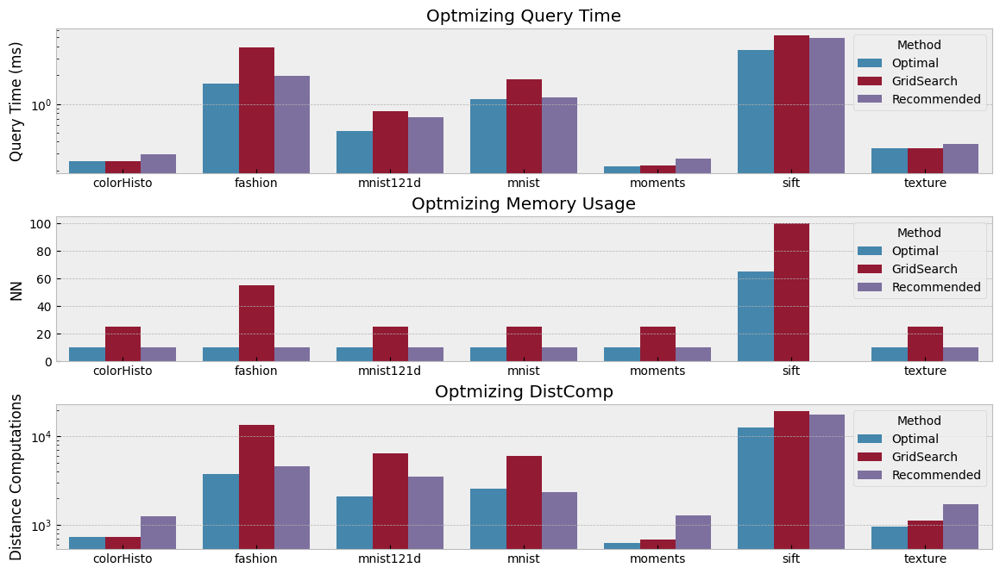

In [29]:
hue_order = ['Optimal', 'GridSearch', 'Recommended']
fig, axes = plt.subplots(3,1, figsize=(14, 8), dpi=100)
ax = axes.reshape(-1)

sns.barplot(x='Dataset', y='Query Time (ms)', hue='Method', hue_order=hue_order, data=final_recommendations[final_recommendations.optmizing=='qt'], ax=ax[0])
ax[0].set_yscale('log')
ax[0].set_xlabel('')
ax[0].set_title('Optmizing Query Time')

sns.barplot(x='Dataset', y='NN', hue='Method', hue_order=hue_order, data=final_recommendations[final_recommendations.optmizing=='mem'], ax=ax[1])
ax[1].set_title('Optmizing Memory Usage')
ax[1].set_xlabel('')

sns.barplot(x='Dataset', y='Distance Computations', hue='Method', hue_order=hue_order, data=final_recommendations[final_recommendations.optmizing=='dc'], ax=ax[2])
ax[2].set_yscale('log')
ax[2].set_title('Optmizing DistComp')
ax[2].set_xlabel('')

plt.subplots_adjust(hspace=0.3)

# Before x Now

<AxesSubplot:xlabel='method', ylabel='r2'>

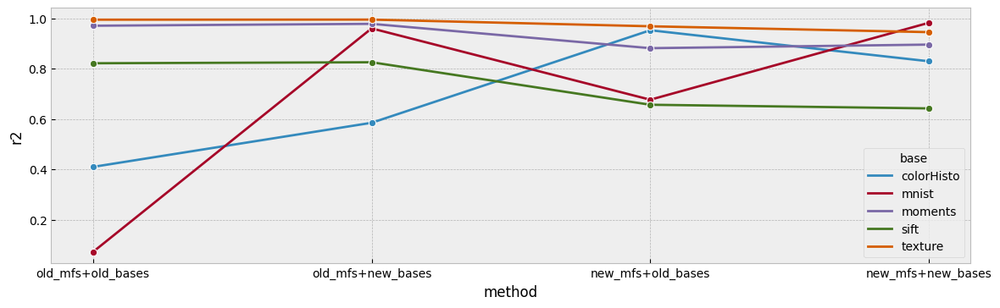

In [135]:
onr = pd.read_csv('data/results/old_new_evaluation.csv')
onr = onr[~onr.base.isin(['fashion', 'mnist121d'])]
# onr.method = onr.method.replace({
#     'new_mfs+new_bases': 'v4',
#     'new_mfs+old_bases': 'v3',
#     'old_mfs+new_bases': 'v2',
#     'old_mfs+old_bases': 'v1',
    
# })
onr.sort_values(by=['base', 'method'])
# onr.loc[21, 'r2'] = 0.96
plt.figure(figsize=(14,4), dpi=100)
# sns.boxplot(x='method', y='r2', data=onr)
sns.lineplot(x='method', y='r2', data=onr, hue='base', marker='o')

In [48]:
onr.groupby('method').r2.mean()

method
new_mfs+new_bases    0.859265
new_mfs+old_bases    0.827485
old_mfs+new_bases    0.869051
old_mfs+old_bases    0.653926
Name: r2, dtype: float64

In [67]:
scores_path = 'data/results/clustering_scores.csv'
scores = pd.read_csv(scores_path)
scores.r2 = scores.r2.apply(lambda x: 0 if x <= 0 else x)
scores.sort_values(by='r2').groupby(['target', 'feature_selection_method']).r2.describe()

count      mean       std       min  \
target    feature_selection_method                                        
DistComp  pca                         7.0  0.970559  0.031173  0.911304   
          pearson                     7.0  0.970382  0.035282  0.905068   
          rf                          7.0  0.980870  0.019545  0.942788   
IndexTime pca                         7.0  0.577175  0.456072  0.000000   
          pearson                     7.0  0.591551  0.492933  0.000000   
          rf                          7.0  0.501711  0.477861  0.000000   
QueryTime pca                         7.0  0.854940  0.139914  0.583398   
          pearson                     7.0  0.890622  0.069044  0.828211   
          rf                          7.0  0.886451  0.083503  0.752944   
Recall    pca                         7.0  0.603630  0.439130  0.000000   
          pearson                     7.0  0.963013  0.027563  0.932971   
          rf                          7.0  0.963013  0.027563  0.932971   

                                         25%       50%       75%       max  
target    feature_selection_method                                          
DistComp  pca                       0.960152  0.980113  0.993748  0.994695  
          pearson                   0.958344  0.974738  0.998575  0.999027  
          rf                        0.976894  0.978448  0.995940  0.999184  
IndexTime pca                       0.166423  0.773031  0.970340  0.993669  
          pearson                   0.104993  0.972693  0.981130  0.995917  
          rf                        0.000000  0.745194  0.889027  0.988729  
QueryTime pca                       0.819083  0.878904  0.950106  0.983903  
          pearson                   0.835195  0.878904  0.929516  0.997818  
          rf                        0.840004  0.881907  0.948689  0.992922  
Recall    pca                       0.265064  0.858020  0.928599  0.980065  
          pearson                   0.939261  0.956236  0.988565  0.996233  
          rf                        0.939261  0.956236  0.988565  0.996233

<AxesSubplot:xlabel='target', ylabel='r2'>

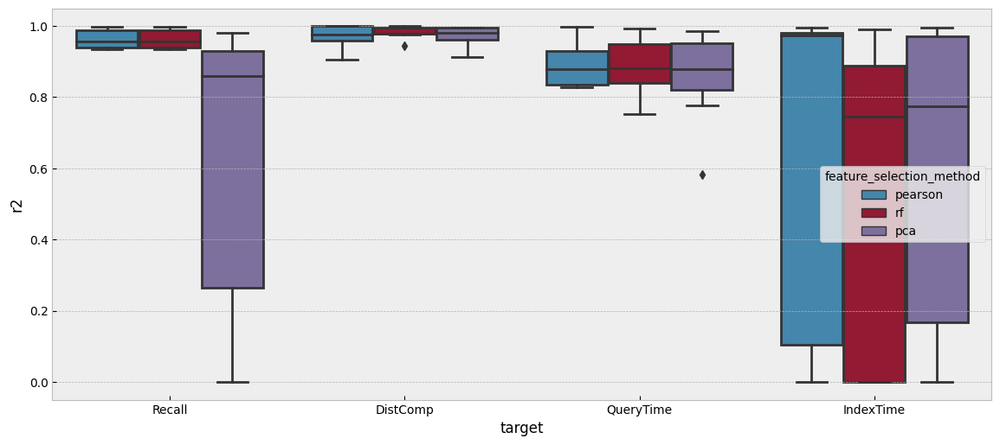

In [68]:
plt.figure(dpi=100, figsize=(14,6))
sns.boxplot(x='target', y='r2', hue='feature_selection_method', data=scores)

In [30]:
info_path = 'data/results/clustering_info.csv'
info = pd.read_csv(info_path)
# info.drop('Unnamed: 0', axis=1, inplace=True)

info_final = info.rename(columns={
    'mean_datatsets_per_cluster': 'mean.mean',
    'std_datatsets_per_cluster': 'std.mean',
    'max_datasets_per_cluster': 'max.mean',
    'min_datasets_per_cluster': 'min.mean',
}).groupby(['fs_method', 'target']).mean().round(4)
info_final.n_outliers = (info_final.n_outliers/337).round(4)
info_final = info_final.rename(columns={'n_outliers': 'outliers(%)'})
info_final

n_clusters  outliers(%)  mean.mean  std.mean  max.mean  \
fs_method target                                                              
pca       DistComp      70.5714       0.1725     3.6962    1.3792    9.0000   
          IndexTime     70.5714       0.1725     3.6962    1.3792    9.0000   
          QueryTime     70.5714       0.1725     3.6962    1.3792    9.0000   
          Recall        15.4286       0.0861    18.8666   16.1606   64.7143   
pearson   DistComp      47.0000       0.1721     5.5537    4.7034   18.0000   
          IndexTime     54.7143       0.1797     4.7233    4.5358   22.7143   
          QueryTime     44.2857       0.1776     5.8551    7.2423   36.2857   
          Recall        61.0000       0.1581     4.3562    2.7532   12.0000   
rf        DistComp      65.1429       0.2454     3.6272    2.5817   12.0000   
          IndexTime     59.0000       0.2281     4.1046    3.2055   17.8571   
          QueryTime     81.0000       0.3145     2.6297    1.1984    8.0000   
          Recall        61.0000       0.1581     4.3562    2.7532   12.0000   

                     min.mean  
fs_method target               
pca       DistComp        2.0  
          IndexTime       2.0  
          QueryTime       2.0  
          Recall          2.0  
pearson   DistComp        2.0  
          IndexTime       2.0  
          QueryTime       2.0  
          Recall          2.0  
rf        DistComp        2.0  
          IndexTime       2.0  
          QueryTime       2.0  
          Recall          2.0

# Feature Importances by RF


In [15]:
importances = pd.read_csv('data/feature_importances.csv')
importances.drop_duplicates(['feature', 'target'], inplace=True)
importances = importances[importances.target != 'IndexTime']
importances.groupby('target').importance.sum() #.value_counts()

target
DistComp     0.039008
QueryTime    0.152078
Recall       0.283192
Name: importance, dtype: float64

Text(0.5, 0, 'Meta-features')

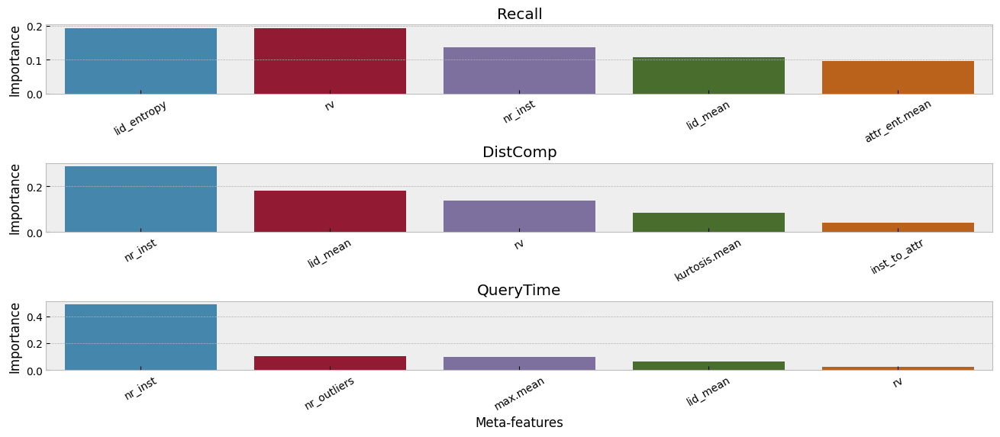

In [17]:
fig, axes = plt.subplots(3,1,dpi=100,figsize=(16,6))
axes = iter(axes.reshape(-1))
plt.subplots_adjust(hspace=1)
for ax, target in zip(axes, importances.target.unique()):
    data = importances[importances.target == target].sort_values(by='importance', ascending=False).copy()
    data.importance = data.importance/data.importance.sum()
    data = data[data.importance >= data.importance.quantile(0.9)]
    sns.barplot(x='feature', y='importance', data=data, ax=ax)
    ax.set_xticklabels(labels = ax.get_xticklabels(), rotation=30)
    ax.set_title(target)
    ax.set_xlabel('')
    ax.set_ylabel('Importance')

ax.set_xlabel('Meta-features')